In [45]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from datetime import datetime
import os
import sys
import threading
import numpy as np
import tensorflow as tf
import glob
from PIL import Image

In [2]:
path = '/root/sxwl-dataset/nas/TDDOWNLOAD/train/'
dst_path = os.path.join(path, 'res_tfrecords')
if not os.path.exists(dst_path):
    os.mkdir(dst_path)

In [48]:
from six.moves import cPickle as pickle

def pickle_to_file(dataset, filename):
    try:
        with open(filename, 'wb') as f:
            pickle.dump(dataset, f, pickle.HIGHEST_PROTOCOL)
    except Exception as e:
        print('Unable to save data to', filename, ':', e)

def unpickle_from_file(pickle_file):
    with open(pickle_file, 'rb') as f:
      dataset = pickle.load(f)
    return dataset

## Helper functions

Create 3-channel-image tfrecords.

Require: 
    - filenames
    - labels

Tfrecords:
    - height
    - width
    - channels
    - label
    - filename
    - encoded

In [49]:
def _int64_feature(value):
    """Wrapper for inserting int64 features into Example proto."""
    if not isinstance(value, list):
        value = [value]
    return tf.train.Feature(int64_list=tf.train.Int64List(value=value))

def _bytes_feature(value):
    """Wrapper for inserting bytes features into Example proto."""
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def _convert_to_example(filename, image_buffer, label, height, width):
    """Build an Example proto for an example.
    Args:
    filename: string, path to an image file, e.g., '/path/to/example.JPG'
    image_buffer: string, JPEG encoding of RGB image
    label: integer, identifier for the ground truth for the network
    text: string, unique human-readable, e.g. 'dog'
    height: integer, image height in pixels
    width: integer, image width in pixels
    Returns:
    Example proto
    """
    channels = 3
    example = tf.train.Example(features=tf.train.Features(feature={
        'height' : _int64_feature(height),
        'width' : _int64_feature(width),
        'channels' : _int64_feature(channels),
        'label' : _int64_feature(label),
        'filename' : _bytes_feature(filename),
        'encoded' : _bytes_feature(image_buffer)
    }))
    return example

In [50]:
class ImageCoder(object):
    """Helper class that provides TensorFlow image coding utilities."""
    
    def __init__(self):
        # Create a single Session to run all image coding calls.
        self._sess = tf.Session()
        
        # Initializes function that converts PNG to JPEG data.
        self._png_data = tf.placeholder(dtype=tf.string)
        image = tf.image.decode_png(self._png_data, channels=3)
        self._png_to_jpeg = tf.image.encode_jpeg(image, format='rgb', quality=100)
        
        # Initializes function that decodes RGB JPEG data.
        self._decode_jpeg_data = tf.placeholder(dtype=tf.string)
        self._decode_jpeg = tf.image.decode_jpeg(self._decode_jpeg_data, channels=3)
        
    def png_to_jpeg(self, image_data):
        return self._sess.run(self._png_to_jpeg,
                              feed_dict={self._png_data: image_data})
    
    def decode_jpeg(self, image_data):
        image = self._sess.run(self._decode_jpeg,
                               feed_dict={self._decode_jpeg_data: image_data})
        assert len(image.shape) == 3
        assert image.shape[2] == 3
        return image
    

In [51]:
def _is_png(filename):
    """Determine if a file contains a PNG format image.
    Args:
    filename: string, path of the image file.
    Returns:
    boolean indicating if the image is a PNG.
    """
    return '.png' in filename

def _process_image(filename, coder):
    """Process a single image file.
    Args:
    filename: string, path to an image file e.g., '/path/to/example.JPG'.
    coder: instance of ImageCoder to provide TensorFlow image coding utils.
    Returns:
    image_buffer: string, JPEG encoding of RGB image.
    height: integer, image height in pixels.
    width: integer, image width in pixels.
    """
    # Read the image file.
    with tf.gfile.FastGFile(filename, 'rb') as f:
        image_data = f.read()
        
    # Convert any PNG to JPEG's for consistency.
    if _is_png(filename):
        print('Converting PNG to JPEG for {}'.format(filename))
        image_data = coder.png_to_jpeg(image_data)
        
    # Decode the RGB JPEG
    # 使用jpeg decode 编码，在相应的解码阶段也要用jpeg的解码器
    image = coder.decode_jpeg(image_data)
    
    # Check that image converted to RGB
    assert len(image.shape) == 3
    height = image.shape[0]
    width = image.shape[1]
    assert image.shape[2] == 3
    return image_data, height, width

In [52]:
def _process_image2(filename):
    img = np.array(Image.open(filename))
    height = img.shape[0]
    width = img.shape[1]
    assert(img.shape[2] == 3)
    img_raw = img.tostring()
    return img_raw, height, width 

In [53]:
def _process_image_files_batch(coder, thread_index, ranges, name, filenames,
                               labels, num_shards,output_directory):
    """Processes and saves list of images as TFRecord in 1 thread.
    Args:
    coder: instance of ImageCoder to provide TensorFlow image coding utils.
    thread_index: integer, unique batch to run index is within [0, len(ranges)).
    ranges: list of pairs of integers specifying ranges of each batches to
      analyze in parallel.
    name: string, unique identifier specifying the data set
    filenames: list of strings; each string is a path to an image file
    texts: list of strings; each string is human readable, e.g. 'dog'
    labels: list of integer; each integer identifies the ground truth
    num_shards: integer number of shards for this data set.
    """
    # Each thread produces N shards where N = int(num_shards / num_threads).
    # For instance, if num_shards = 128, and the num_threads = 2, then the first
    # thread would produce shards [0, 64).
    num_threads = len(ranges)
    assert not num_shards % num_threads
    # 每个线程需要处理成多少个shards，shards就是一个数据卷
    num_shards_per_batch = int(num_shards / num_threads)
    
    # 这个线程需要处理的range, 把这个range再分成几个数据卷
    shard_ranges = np.linspace(ranges[thread_index][0],
                               ranges[thread_index][1],
                               num_shards_per_batch + 1).astype(int)
    # 这个线程需要处理的所有files
    num_files_in_thread = ranges[thread_index][1] - ranges[thread_index][0]
    
    # 这个线程处理图片的计数
    counter = 0
    # 循环多少个数据卷
    for s in range(num_shards_per_batch):
        # Generate a sharded version of the file name, e.g. 'train-00002-of-00010'
        shard = thread_index * num_shards_per_batch + s
        output_filename = '%s-%.5d-of-%.5d' % (name, shard, num_shards)
        output_file = os.path.join(output_directory, output_filename)
        writer = tf.python_io.TFRecordWriter(output_file)
        
        # 这个数据卷处理图片的计数
        shard_counter = 0
        # 该数据卷的文件的index范围
        files_in_shard = np.arange(shard_ranges[s], shard_ranges[s + 1], dtype=int)
        # 每个数据卷的所有文件
        for i in files_in_shard:
            filename = filenames[i]
            label = labels[i]
            # text = texts[i]
            
            try:
                image_buffer, height, width = _process_image2(filename)
            except Exception as e:
                print(e)
                print('SKIPPED: Unexpected error while decoding {}'.format(filenames))
                continue
                
            example = _convert_to_example(filename, image_buffer,
                                          label, height, width)
            writer.write(example.SerializeToString())
            shard_counter += 1
            counter += 1
            
            if not counter % 1000:
                print('%s [thread %d]: Processing %d of %d images in thread batch.' %
                      (datetime.now(), thread_index, counter, num_files_in_thread))
                sys.stdout.flush()
                
        writer.close()
        
        # 打印这个数据卷一共有多少个image写入
        print('%s [thread %d]: Wrote %d images to %s' %
          (datetime.now(), thread_index, shard_counter, output_file))
        sys.stdout.flush()
        shard_counter = 0
        
    # 打印这个线程一共处理了多少个image
    print('%s [thread %d]: Wrote %d images to %d shards.' % 
          (datetime.now(), thread_index, counter, num_files_in_thread))
    sys.stdout.flush()

In [54]:
def convert2tfrecord(name, filenames, labels, num_shards, output_directory, num_threads):
    """Process and save list of images as TFRecord of Example protos.
    Args:
    name: string, unique identifier specifying the data set
    filenames: list of strings; each string is a path to an image file
    texts: list of strings; each string is human readable, e.g. 'dog'
    labels: list of integer; each integer identifies the ground truth
    num_shards: integer number of shards for this data set.
    """
    assert len(filenames) == len(labels)
    
    # Break all images into batches with a [ranges[i][0], ranges[i][1]].
    spacing = np.linspace(0, len(filenames), num_threads + 1).astype(np.int)
    ranges = []
    for i in range(len(spacing) - 1):
        ranges.append([spacing[i], spacing[i + 1]])
        
    # Launch a thread for each batch.
    print('Lauching %d threads for spacings: %s' % (num_threads, ranges))
    sys.stdout.flush()
    
    # Create a mechanism for monitoring when all threadsd are finished.
    coord = tf.train.Coordinator()
    
    # Create a generic TensorFlow-based utility for converting all image codings
    coder = ImageCoder()
    
    threads = []
    for thread_index in range(len(ranges)):
        args = (coder, thread_index, ranges, name, filenames,
                labels, num_shards, output_directory)
        t = threading.Thread(target=_process_image_files_batch, args=args)
        t.start()
        threads.append(t)
        
    # Wait for all the threads to terminate.
    coord.join(threads)
    print('%s: Finished writing all %d images in data set.' %
          (datetime.now(), len(filenames)))
    sys.stdout.flush()

## Create Tfrecords

In [59]:
fnames_path = os.path.join(dst_path, 'fnames.pkl')
ids_labels_path = os.path.join(dst_path, 'ids_to_labels.pkl')
labels_path = os.path.join(dst_path, 'labels.pkl')

In [17]:
fnames = list(glob.iglob(path + '*/*.JPEG'))

In [18]:
len(fnames)

19439

In [24]:
ids_to_labels = {}
label_count = 0
labels = []
for fname in fnames:
    id = fname.split('/')[-2]
    if id in ids_to_labels:
        labels.append(ids_to_labels[id])
        continue
    else:
        ids_to_labels[id] = label_count
        labels.append(label_count)
        label_count += 1
        

In [23]:
ids_to_labels

{'n01440764': 565,
 'n01443537': 591,
 'n01491361': 753,
 'n01494475': 577,
 'n01498041': 168,
 'n01514668': 661,
 'n01514859': 393,
 'n01518878': 707,
 'n01530575': 684,
 'n01531178': 641,
 'n01534433': 9,
 'n01537544': 333,
 'n01558993': 1,
 'n01560419': 692,
 'n01580077': 324,
 'n01582220': 409,
 'n01592084': 771,
 'n01608432': 477,
 'n01614925': 47,
 'n01616318': 292,
 'n01631663': 475,
 'n01632458': 738,
 'n01632777': 305,
 'n01641577': 120,
 'n01644373': 212,
 'n01664065': 645,
 'n01665541': 503,
 'n01667778': 190,
 'n01685808': 556,
 'n01687978': 129,
 'n01689811': 360,
 'n01692333': 388,
 'n01695060': 381,
 'n01704323': 560,
 'n01729322': 520,
 'n01735189': 363,
 'n01742172': 232,
 'n01749939': 12,
 'n01755581': 515,
 'n01756291': 466,
 'n01768244': 111,
 'n01770393': 304,
 'n01774384': 200,
 'n01774750': 63,
 'n01775062': 217,
 'n01776313': 347,
 'n01784675': 674,
 'n01796340': 728,
 'n01797886': 447,
 'n01798484': 273,
 'n01806143': 259,
 'n01806567': 742,
 'n01807496': 545,


In [36]:
pickle_to_file(fnames, fnames_path)
pickle_to_file(ids_to_labels, ids_labels_path)
pickle_to_file(labels, labels_path)

In [60]:
fnames = unpickle_from_file(fnames_path)
ids_to_labels = unpickle_from_file(ids_labels_path)
labels = unpickle_from_file(labels_path)

In [61]:
len(fnames) == len(labels)

True

In [62]:
name = 'imagenet'

In [ ]:
convert2tfrecord(name=name, filenames=fnames, labels=labels, 
                 num_shards=16, output_directory=dst_path, num_threads=8)

Lauching 8 threads for spacings: [[0, 2429], [2429, 4859], [4859, 7289], [7289, 9719], [9719, 12149], [12149, 14579], [14579, 17009], [17009, 19439]]
tuple index out of range
SKIPPED: Unexpected error while decoding ['/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_4857.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_6384.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_480.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_7523.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_1302.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_229.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_5416.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_753.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_8770.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_4888.JPEG', '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n0771

In [5]:
!ls  {dst_path}/imagenet*

/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00000-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00001-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00002-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00003-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00004-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00005-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00006-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00007-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00008-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00009-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00010-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00011-of-00016
/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-0

## Read tfrecord

In [22]:
def read_and_decode(filename_queue):
    reader = tf.TFRecordReader()
    _, serialized_example = reader.read(filename_queue)
    features = tf.parse_single_example(
      serialized=serialized_example,
      # Defaults are not specified since both keys are required.
      features={
          'height': tf.FixedLenFeature([], tf.int64),
          'width': tf.FixedLenFeature([], tf.int64),
          'channels': tf.FixedLenFeature([], tf.int64),
          'label': tf.FixedLenFeature([], tf.int64),
          'filename': tf.FixedLenFeature([], tf.string),
          'encoded': tf.FixedLenFeature([], tf.string)
      }
    )

    image = tf.image.decode_jpeg(features['encoded'], channels=3)
    image = tf.cast(image, tf.float32)
    height = tf.cast(features['height'], tf.int32)
    width = tf.cast(features['width'], tf.int32)
    channels = tf.cast(features['channels'], tf.int32)
    img_shp = tf.stack([height, width, channels])
    image = tf.reshape(image, img_shp)
    label = tf.cast(features['label'], tf.int32)
    return image, label

In [23]:
def inputs(filepaths, batch_size, num_epochs):
    if not num_epochs: num_epochs = None

    with tf.name_scope('input'):
        filename_queue = tf.train.string_input_producer(
            filepaths, num_epochs=num_epochs)

    image, label = read_and_decode(filename_queue)
    images, labels = tf.train.shuffle_batch(
        [image, label], batch_size=batch_size, num_threads=4,
        capacity=100 + 3 * batch_size,
        # Ensures a minimum amount of shuffling of examples.
        min_after_dequeue=100)
    return images, labels

In [4]:
tfrecords =  !ls {dst_path}/imagenet*

In [24]:
images, labels = inputs(filepaths=tfrecords, batch_size=1, num_epochs=10)

ValueError: All shapes must be fully defined: [TensorShape([Dimension(None), Dimension(None), Dimension(None)]), TensorShape([])]

In [13]:
# The op for initializing the variables.
init_op = tf.group(tf.global_variables_initializer(),
                   tf.local_variables_initializer())


In [14]:
sess = tf.Session()

In [15]:
with sess.as_default():
    sess.run(init_op)

    coord = tf.train.Coordinator()
    threads = tf.train.start_queue_runners(coord=coord)
    img, = sess.run(images)

INFO:tensorflow:Error reported to Coordinator: <class 'tensorflow.python.framework.errors_impl.InvalidArgumentError'>, Input to reshape is a tensor with 235200 values, but the requested shape has 499500
	 [[Node: Reshape_1 = Reshape[T=DT_FLOAT, Tshape=DT_INT32, _device="/job:localhost/replica:0/task:0/gpu:0"](Cast_2, Reshape_1/shape)]]

Caused by op u'Reshape_1', defined at:
  File "/root/anaconda2/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/root/anaconda2/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/root/anaconda2/lib/python2.7/site-packages/traitlets/config/application.py", line 596, in launch_instance
    app.start()
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/kernelapp.py", line 477, in start
    ioloop.IOLoop.instance().start()
  File "

OutOfRangeError: RandomShuffleQueue '_7_shuffle_batch_1/random_shuffle_queue' is closed and has insufficient elements (requested 1, current size 0)
	 [[Node: shuffle_batch_1 = QueueDequeueManyV2[component_types=[DT_FLOAT, DT_INT32], timeout_ms=-1, _device="/job:localhost/replica:0/task:0/cpu:0"](shuffle_batch_1/random_shuffle_queue, shuffle_batch_1/n)]]

Caused by op u'shuffle_batch_1', defined at:
  File "/root/anaconda2/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/root/anaconda2/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/root/anaconda2/lib/python2.7/site-packages/traitlets/config/application.py", line 596, in launch_instance
    app.start()
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/kernelapp.py", line 477, in start
    ioloop.IOLoop.instance().start()
  File "/root/anaconda2/lib/python2.7/site-packages/zmq/eventloop/ioloop.py", line 162, in start
    super(ZMQIOLoop, self).start()
  File "/root/anaconda2/lib/python2.7/site-packages/tornado/ioloop.py", line 883, in start
    handler_func(fd_obj, events)
  File "/root/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 275, in null_wrapper
    return fn(*args, **kwargs)
  File "/root/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 440, in _handle_events
    self._handle_recv()
  File "/root/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 472, in _handle_recv
    self._run_callback(callback, msg)
  File "/root/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/root/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 275, in null_wrapper
    return fn(*args, **kwargs)
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/ipkernel.py", line 196, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/root/anaconda2/lib/python2.7/site-packages/ipykernel/zmqshell.py", line 533, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/root/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2723, in run_cell
    interactivity=interactivity, compiler=compiler, result=result)
  File "/root/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2825, in run_ast_nodes
    if self.run_code(code, result):
  File "/root/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2885, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-12-d4e10de42bf0>", line 2, in <module>
    images, labels = inputs(filepaths=tfrecords, batch_size=1, num_epochs=10)
  File "<ipython-input-11-29aca8fa5283>", line 13, in inputs
    min_after_dequeue=100)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/training/input.py", line 1214, in shuffle_batch
    name=name)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/training/input.py", line 784, in _shuffle_batch
    dequeued = queue.dequeue_many(batch_size, name=name)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/data_flow_ops.py", line 458, in dequeue_many
    self._queue_ref, n=n, component_types=self._dtypes, name=name)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/gen_data_flow_ops.py", line 1328, in _queue_dequeue_many_v2
    timeout_ms=timeout_ms, name=name)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/op_def_library.py", line 768, in apply_op
    op_def=op_def)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 2336, in create_op
    original_op=self._default_original_op, op_def=op_def)
  File "/root/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 1228, in __init__
    self._traceback = _extract_stack()

OutOfRangeError (see above for traceback): RandomShuffleQueue '_7_shuffle_batch_1/random_shuffle_queue' is closed and has insufficient elements (requested 1, current size 0)
	 [[Node: shuffle_batch_1 = QueueDequeueManyV2[component_types=[DT_FLOAT, DT_INT32], timeout_ms=-1, _device="/job:localhost/replica:0/task:0/cpu:0"](shuffle_batch_1/random_shuffle_queue, shuffle_batch_1/n)]]


In [5]:
reconstructed_images = []

In [41]:
tfrecords

['/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00000-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00001-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00002-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00003-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00004-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00005-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00006-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00007-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00008-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00009-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00010-of-00016',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/res_tfrecords/imagenet-00011-of-00016',
 '/root/sxwl-dat

In [42]:
record_iterator = tf.python_io.tf_record_iterator(path=tfrecords[0])

In [43]:
for string_record in record_iterator:
    example = tf.train.Example()
    example.ParseFromString(string_record)
    height = int(example.features.feature['height'].int64_list.value[0])
    width = int(example.features.feature['width'].int64_list.value[0])
    channels = int(example.features.feature['channels'].int64_list.value[0])
    img_string = (example.features.feature['encoded'].bytes_list.value[0])
    img_1d = tf.image.decode_jpeg(img_string, channels=3)
    #img_1d = np.fromstring(img_string, dtype=np.uint8)
    print(img_1d.shape)
    print(height)
    print(width)
    print(channels)
    print(height * width * channels)
    reconstructed_img = img_1d.reshape((height, width, channels))
    reconstructed_images.append(reconstructed_img)

(?, ?, 3)
375
500
3
562500


AttributeError: 'Tensor' object has no attribute 'reshape'

## Test

In [29]:
filename_pairs = fnames[:10];filename_pairs

['/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_4857.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_6384.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_480.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_7523.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_1302.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_229.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_5416.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_753.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_8770.JPEG',
 '/root/sxwl-dataset/nas/TDDOWNLOAD/train/n07711569/n07711569_4888.JPEG']

In [32]:
%matplotlib inline

# Important: We are using PIL to read .png files later.
# This was done on purpose to read indexed png files
# in a special way -- only indexes and not map the indexes
# to actual rgb values. This is specific to PASCAL VOC
# dataset data. If you don't want thit type of behaviour
# consider using skimage.io.imread()
from PIL import Image
import numpy as np
import skimage.io as io
import tensorflow as tf


def _bytes_feature(value):
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def _int64_feature(value):
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

tfrecords_filename = 'pascal_voc_segmentation.tfrecords'

writer = tf.python_io.TFRecordWriter(tfrecords_filename)

# Let's collect the real images to later on compare
# to the reconstructed ones
original_images = []

for img_path in filename_pairs:
    
    img = np.array(Image.open(img_path))
    #annotation = np.array(Image.open(annotation_path))
    
    # The reason to store image sizes was demonstrated
    # in the previous example -- we have to know sizes
    # of images to later read raw serialized string,
    # convert to 1d array and convert to respective
    # shape that image used to have.
    height = img.shape[0]
    width = img.shape[1]
    
    # Put in the original images into array
    # Just for future check for correctness
    original_images.append((img))
    
    img_raw = img.tostring()
    #annotation_raw = annotation.tostring()
    
    example = tf.train.Example(features=tf.train.Features(feature={
        'height': _int64_feature(height),
        'width': _int64_feature(width),
        'image_raw': _bytes_feature(img_raw),
        #'mask_raw': _bytes_feature(annotation_raw)
    }))
    
    writer.write(example.SerializeToString())

writer.close()

In [33]:
reconstructed_images = []

record_iterator = tf.python_io.tf_record_iterator(path=tfrecords_filename)

for string_record in record_iterator:
    
    example = tf.train.Example()
    example.ParseFromString(string_record)
    
    height = int(example.features.feature['height']
                                 .int64_list
                                 .value[0])
    
    width = int(example.features.feature['width']
                                .int64_list
                                .value[0])
    
    img_string = (example.features.feature['image_raw']
                                  .bytes_list
                                  .value[0])
    
#     annotation_string = (example.features.feature['mask_raw']
#                                 .bytes_list
#                                 .value[0])
    
    img_1d = np.fromstring(img_string, dtype=np.uint8)
    reconstructed_img = img_1d.reshape((height, width, -1))
    
#     annotation_1d = np.fromstring(annotation_string, dtype=np.uint8)
    
    # Annotations don't have depth (3rd dimension)
#     reconstructed_annotation = annotation_1d.reshape((height, width))
    
    reconstructed_images.append((reconstructed_img))

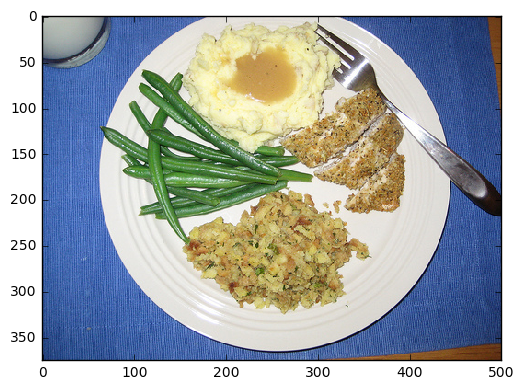

In [38]:
io.imshow(reconstructed_images[0])